In [1]:
import numpy as np
import pandas as pd

from bokeh.plotting import figure, output_file, show
from bokeh.models import ColumnDataSource
from bokeh.models.tools import HoverTool

import seaborn as sns

import matplotlib.pyplot as plt

In [2]:
data = pd.read_csv('listings-2.csv')

In [3]:
data.columns

Index(['id', 'listing_url', 'scrape_id', 'last_scraped', 'name', 'description',
       'neighborhood_overview', 'picture_url', 'host_id', 'host_url',
       'host_name', 'host_since', 'host_location', 'host_about',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_thumbnail_url', 'host_picture_url',
       'host_neighbourhood', 'host_listings_count',
       'host_total_listings_count', 'host_verifications',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'neighbourhood_cleansed', 'neighbourhood_group_cleansed', 'latitude',
       'longitude', 'property_type', 'room_type', 'accommodates', 'bathrooms',
       'bathrooms_text', 'bedrooms', 'beds', 'amenities', 'price',
       'minimum_nights', 'maximum_nights', 'minimum_minimum_nights',
       'maximum_minimum_nights', 'minimum_maximum_nights',
       'maximum_maximum_nights', 'minimum_nights_avg_ntm',
       'maximum_nights_avg_ntm', 'calendar_upd

In [4]:
data.shape

(33630, 74)

In [5]:
data.head(5)

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,11156,https://www.airbnb.com/rooms/11156,20210208234740,2021-02-10,An Oasis in the City,Very central to the city which can be reached ...,"It is very close to everything and everywhere,...",https://a0.muscache.com/pictures/2797669/17895...,40855,https://www.airbnb.com/users/show/40855,...,10.0,10.0,10.0,NaN,f,1,0,1,0,1.44
1,12351,https://www.airbnb.com/rooms/12351,20210208234740,2021-02-10,Sydney City & Harbour at the door,Come stay with Vinh & Stuart (Awarded as one o...,"Pyrmont is an inner-city village of Sydney, on...",https://a0.muscache.com/pictures/763ad5c8-c951...,17061,https://www.airbnb.com/users/show/17061,...,10.0,10.0,10.0,NaN,f,2,0,2,0,4.09
2,14250,https://www.airbnb.com/rooms/14250,20210208234740,2021-02-10,Manly Harbour House,"Beautifully renovated, spacious and quiet, our...",Balgowlah Heights is one of the most prestigio...,https://a0.muscache.com/pictures/56935671/fdb8...,55948,https://www.airbnb.com/users/show/55948,...,8.0,9.0,8.0,NaN,f,2,2,0,0,0.03
3,15253,https://www.airbnb.com/rooms/15253,20210208234740,2021-02-10,Unique Designer Rooftop Apartment in City Loca...,Penthouse living at it best ... You will be st...,The location is really central and there is nu...,https://a0.muscache.com/pictures/46dcb8a1-5d5b...,59850,https://www.airbnb.com/users/show/59850,...,10.0,10.0,9.0,NaN,t,1,0,1,0,3.34
4,44545,https://www.airbnb.com/rooms/44545,20210208234740,2021-02-10,Sunny Darlinghurst Warehouse Apartment,Sunny warehouse/loft apartment in the heart of...,Darlinghurst is home to some of Sydney's best ...,https://a0.muscache.com/pictures/a88d8e14-4f63...,112237,https://www.airbnb.com/users/show/112237,...,10.0,10.0,10.0,NaN,f,1,1,0,0,0.61


In [6]:
from __future__ import division, print_function, unicode_literals
# Common imports
import numpy as np
import os
import pandas as pd

# to make this notebook's output stable across runs
np.random.seed(42)

# To plot pretty figures
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['figure.figsize'] = (10,7)

# Where to save the figures
PROJECT_ROOT_DIR = "."
CHAPTER_ID = "end_to_end_project"
IMAGES_PATH = os.path.join(PROJECT_ROOT_DIR, "images", CHAPTER_ID)

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(IMAGES_PATH, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    try:
        plt.savefig(path, format=fig_extension, dpi=resolution)
    except:
        plt.savefig(fig_id + "." + fig_extension, format=fig_extension, dpi=resolution)

# Ignore useless warnings (see SciPy issue #5998)
import warnings
warnings.filterwarnings(action="ignore", message="^internal gelsd")
pd.options.display.max_columns = None

In [7]:
data.tail(5)

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
33625,48083332,https://www.airbnb.com/rooms/48083332,20210208234740,2021-02-10,2bedroom camperdown apartment D52,You'll have use of my allocated parking spot f...,NaN,https://a0.muscache.com/pictures/b1fd16ef-236b...,91961414,https://www.airbnb.com/users/show/91961414,Kimi,2016-08-26,"Sydney, New South Wales, Australia",I look forward to being your host here in sydn...,within an hour,99%,99%,f,https://a0.muscache.com/im/pictures/user/b5e62...,https://a0.muscache.com/im/pictures/user/b5e62...,Ultimo,50.0,50.0,"['email', 'phone', 'reviews', 'offline_governm...",t,t,NaN,Sydney,NaN,-33.88618,151.17894,Entire apartment,Entire home/apt,7,NaN,2 baths,2.0,4.0,"[""Bed linens"", ""Hair dryer"", ""TV"", ""Heating"", ...",$166.00,1,180,1,1,1125,1125,1.0,1125.0,NaN,t,20,49,79,80,2021-02-10,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,t,45,45,0,0,NaN
33626,48085120,https://www.airbnb.com/rooms/48085120,20210208234740,2021-02-10,HOLIDAY EVERYDAY,"NEAR NEW, FULLY FURNISHED Boutique 1 Bedroom A...",NaN,https://a0.muscache.com/pictures/d6a82783-39bb...,135627161,https://www.airbnb.com/users/show/135627161,Toni,2017-06-18,"Kingsford, New South Wales, Australia",NaN,NaN,NaN,NaN,f,https://a0.muscache.com/im/pictures/user/ddbca...,https://a0.muscache.com/im/pictures/user/ddbca...,NaN,1.0,1.0,"['email', 'phone', 'facebook']",t,f,NaN,Randwick,NaN,-33.91787,151.25444,Entire apartment,Entire home/apt,4,NaN,1 bath,1.0,1.0,"[""Washer"", ""Iron"", ""Free parking on premises"",...",$137.00,90,1125,90,90,1125,1125,90.0,1125.0,NaN,t,16,46,76,351,2021-02-10,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,t,2,2,0,0,NaN
33627,48085308,https://www.airbnb.com/rooms/48085308,20210208234740,2021-02-10,YOUR HOME AWAY FROM HOME,LUXURY 1 BEDROOM APARTMENT WITH BALCONY & PARK...,NaN,https://a0.muscache.com/pictures/fe9abb83-acc4...,135627161,https://www.airbnb.com/users/show/135627161,Toni,2017-06-18,"Kingsford, New South Wales, Australia",NaN,NaN,NaN,NaN,f,https://a0.muscache.com/im/pictures/user/ddbca...,https://a0.muscache.com/im/pictures/user/ddbca...,NaN,1.0,1.0,"['email', 'phone', 'facebook']",t,f,NaN,Randwick,NaN,-33.90681,151.25012,Entire apartment,Entire home/apt,2,NaN,1 bath,1.0,1.0,"[""Washer"", ""Free parking on premises"", ""Long t...",$90.00,120,1125,120,120,1125,1125,120.0,1125.0,NaN,t,30,60,90,365,2021-02-10,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,t,2,2,0,0,NaN
33628,48087315,https://www.airbnb.com/rooms/48087315,20210208234740,2021-02-10,Enjoyable Bed In Dormitory With Shared Bathroo...,Stop at The building to discover the wonders o...,NaN,https://a0.muscache.com/pictures/05eb7c09-607a...,344804377,https://www.airbnb.com/users/show/344804377,Hristina,2020

In [8]:
data.shape

(33630, 74)

In [9]:
data.columns

Index(['id', 'listing_url', 'scrape_id', 'last_scraped', 'name', 'description',
       'neighborhood_overview', 'picture_url', 'host_id', 'host_url',
       'host_name', 'host_since', 'host_location', 'host_about',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_thumbnail_url', 'host_picture_url',
       'host_neighbourhood', 'host_listings_count',
       'host_total_listings_count', 'host_verifications',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'neighbourhood_cleansed', 'neighbourhood_group_cleansed', 'latitude',
       'longitude', 'property_type', 'room_type', 'accommodates', 'bathrooms',
       'bathrooms_text', 'bedrooms', 'beds', 'amenities', 'price',
       'minimum_nights', 'maximum_nights', 'minimum_minimum_nights',
       'maximum_minimum_nights', 'minimum_maximum_nights',
       'maximum_maximum_nights', 'minimum_nights_avg_ntm',
       'maximum_nights_avg_ntm', 'calendar_upd

In [10]:
data['bathrooms'] = pd.to_numeric(data.bathrooms_text.str.partition(' ')[0],errors = 'coerce')
#data.bathrooms.isna().sum()

In [11]:
#data.bathrooms.dropna(inplace = True)

In [12]:
data.neighbourhood_cleansed.value_counts()

Sydney              8074
Waverley            4737
Randwick            3045
Warringah           1705
Manly               1631
Woollahra           1382
North Sydney        1188
Pittwater           1165
Marrickville        1111
Rockdale             855
Leichhardt           817
Botany Bay           628
Ryde                 594
Parramatta           537
Sutherland Shire     510
Mosman               480
Willoughby           477
Hornsby              425
Canada Bay           383
Auburn               377
Canterbury           337
Ku-Ring-Gai          306
The Hills Shire      295
Lane Cove            284
Blacktown            276
Bankstown            259
Ashfield             255
Burwood              230
City Of Kogarah      214
Hurstville           180
Strathfield          178
Penrith              165
Liverpool            138
Campbelltown         107
Holroyd               96
Fairfield             86
Camden                52
Hunters Hill          51
Name: neighbourhood_cleansed, dtype: int64

In [13]:
data['city'] = data.neighbourhood_cleansed

In [14]:
incl = ["price","city",'amenities',"longitude","latitude","review_scores_rating","number_of_reviews","minimum_nights","accommodates","bathrooms","bedrooms","beds","property_type","room_type","availability_365" ,"host_identity_verified", "host_is_superhost","host_since"] 

In [15]:
df = data[incl]

In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33630 entries, 0 to 33629
Data columns (total 18 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   price                   33630 non-null  object 
 1   city                    33630 non-null  object 
 2   amenities               33630 non-null  object 
 3   longitude               33630 non-null  float64
 4   latitude                33630 non-null  float64
 5   review_scores_rating    22376 non-null  float64
 6   number_of_reviews       33630 non-null  int64  
 7   minimum_nights          33630 non-null  int64  
 8   accommodates            33630 non-null  int64  
 9   bathrooms               33524 non-null  float64
 10  bedrooms                31421 non-null  float64
 11  beds                    33225 non-null  float64
 12  property_type           33630 non-null  object 
 13  room_type               33630 non-null  object 
 14  availability_365        33630 non-null

In [17]:
df2 = df.copy()

In [18]:
#Percentage of missing values
df.isna().sum()/df.shape[0]*100

price                      0.000000
city                       0.000000
amenities                  0.000000
longitude                  0.000000
latitude                   0.000000
review_scores_rating      33.464169
number_of_reviews          0.000000
minimum_nights             0.000000
accommodates               0.000000
bathrooms                  0.315195
bedrooms                   6.568540
beds                       1.204282
property_type              0.000000
room_type                  0.000000
availability_365           0.000000
host_identity_verified     0.101100
host_is_superhost          0.101100
host_since                 0.101100
dtype: float64

In [19]:
#cap maximum nights in australia at 180 days - government order
df.minimum_nights.max()

1125

In [20]:
#df['minimum_nights'] = 
#df[df['minimum_nights']>180]['minimum_nights'] = 180
#df.minimum_nights.value_counts().sort_index()

df['minimum_nights'] = df['minimum_nights'].apply(lambda x: x if x <= 180 else 180 )
df.minimum_nights.value_counts().sort_index()

<ipython-input-20-bc9af69eec17>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minimum_nights'] = df['minimum_nights'].apply(lambda x: x if x <= 180 else 180 )


1      9287
2      7883
3      4903
4      1918
5      2861
       ... 
150       6
152       1
168       1
178       1
180     129
Name: minimum_nights, Length: 79, dtype: int64

In [21]:
df['host_since'] = pd.to_datetime(df['host_since'])
df['days_on_airbnb'] = (pd.to_datetime('today') - df['host_since']).dt.days
df.drop(columns = ['host_since'],inplace = True)

<ipython-input-21-b96672c0f892>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['host_since'] = pd.to_datetime(df['host_since'])
<ipython-input-21-b96672c0f892>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['days_on_airbnb'] = (pd.to_datetime('today') - df['host_since']).dt.days
/opt/anaconda3/lib/python3.8/site-packages/pandas/core/frame.py:4163: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.

In [22]:
moisturizers_dry = df.copy()

ingredient_idx = {}
corpus = []
idx = 0 

for i in range(len(moisturizers_dry)):    
    ingredients = moisturizers_dry['amenities'][i]
    ingredients_lower = ingredients.lower()
    tokens = ingredients_lower.split(', ')
    corpus.append(tokens)
    for ingredient in tokens:
        if ingredient not in ingredient_idx:
            ingredient_idx[ingredient] = idx
            idx += 1



In [23]:
M = len(moisturizers_dry)     
N = len(ingredient_idx)

A = np.zeros((M, N))
print(A.shape)

(33630, 925)


In [24]:
def oh_encoder(tokens):
    x = np.zeros(N)    
    for ingredient in tokens:
        idx = ingredient_idx[ingredient]
        x[idx] = 1
    return x

i = 0
for tokens in corpus:
    A[i, :] = oh_encoder(tokens)
    i += 1

A

array([[1., 1., 1., ..., 0., 0., 0.],
       [1., 1., 0., ..., 0., 0., 0.],
       [1., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [25]:
ingredient_idx

{'["patio or balcony"': 0,
 '"garden or backyard"': 1,
 '"bed linens"': 2,
 '"shampoo"': 3,
 '"hair dryer"': 4,
 '"tv"': 5,
 '"fire extinguisher"': 6,
 '"heating"': 7,
 '"washer"': 8,
 '"iron"': 9,
 '"essentials"': 10,
 '"single level home"': 11,
 '"cooking basics"': 12,
 '"shower gel"': 13,
 '"extra pillows and blankets"': 14,
 '"kitchen"': 15,
 '"elevator"': 16,
 '"refrigerator"': 17,
 '"dishwasher"': 18,
 '"oven"': 19,
 '"stove"': 20,
 '"long term stays allowed"': 21,
 '"microwave"': 22,
 '"hot water"': 23,
 '"dishes and silverware"': 24,
 '"hangers"': 25,
 '"wifi"': 26,
 '"smoke alarm"]': 27,
 '"coffee maker"': 28,
 '"first aid kit"': 29,
 '"paid parking off premises"': 30,
 '"private entrance"': 31,
 '"host greets you"': 32,
 '"lock on bedroom door"': 33,
 '"carbon monoxide alarm"': 34,
 '"breakfast"': 35,
 '"air conditioning"': 36,
 '"dedicated workspace"': 37,
 '"luggage dropoff allowed"': 38,
 '"fireplace guards"': 39,
 '"dryer"': 40,
 '"free street parking"': 41,
 '"bathtub"':

In [26]:
from sklearn.decomposition import PCA
model = PCA(n_components = 2, random_state = 42)
tsne_features = model.fit_transform(A)

moisturizers_dry['X'] = tsne_features[:, 0]
moisturizers_dry['Y'] = tsne_features[:, 1]

In [27]:
from bokeh.io import show, output_notebook, push_notebook
from bokeh.plotting import figure
from bokeh.models import ColumnDataSource, HoverTool
output_notebook()

source = ColumnDataSource(moisturizers_dry)
plot = figure(x_axis_label = 'PCA 1',
              y_axis_label = 'PCA 2', 
              width = 500, height = 400)
plot.circle(x = 'X', 
            y = 'Y', 
            source = source, 
            size = 10, color = '#FF7373', alpha = .3)

Loading BokehJS ...

GlyphRenderer(id='1037', ...)

In [28]:
ingredient_idx.keys()

dict_keys(['["patio or balcony"', '"garden or backyard"', '"bed linens"', '"shampoo"', '"hair dryer"', '"tv"', '"fire extinguisher"', '"heating"', '"washer"', '"iron"', '"essentials"', '"single level home"', '"cooking basics"', '"shower gel"', '"extra pillows and blankets"', '"kitchen"', '"elevator"', '"refrigerator"', '"dishwasher"', '"oven"', '"stove"', '"long term stays allowed"', '"microwave"', '"hot water"', '"dishes and silverware"', '"hangers"', '"wifi"', '"smoke alarm"]', '"coffee maker"', '"first aid kit"', '"paid parking off premises"', '"private entrance"', '"host greets you"', '"lock on bedroom door"', '"carbon monoxide alarm"', '"breakfast"', '"air conditioning"', '"dedicated workspace"', '"luggage dropoff allowed"', '"fireplace guards"', '"dryer"', '"free street parking"', '"bathtub"', '"lockbox"', '"cable tv"', '["coffee maker"', '"beach essentials"', '"ethernet connection"', '"children\\u2019s books and toys"', '"babysitter recommendations"', '"keypad"', '"smoke alarm"'

In [29]:
hover = HoverTool(tooltips = [('City', '@city'),
                              ('Price', '$@price'),
                              ('Amenities', '@amenities')
                              ])
plot.add_tools(hover)

In [30]:
#'Similar Properties based on amenities'
show(plot)

In [31]:
A.shape

(33630, 925)

In [32]:
len(ingredient_idx.keys())

925

In [33]:
amenities_list = list(ingredient_idx.keys())
print(len(amenities_list))

cleaned_amenities_list = []
for i in amenities_list:
    cleaned_amenities_list.append(list(i)[1:-2])
    print(list(i)[1:-2])

925
['"', 'p', 'a', 't', 'i', 'o', ' ', 'o', 'r', ' ', 'b', 'a', 'l', 'c', 'o', 'n']
['g', 'a', 'r', 'd', 'e', 'n', ' ', 'o', 'r', ' ', 'b', 'a', 'c', 'k', 'y', 'a', 'r']
['b', 'e', 'd', ' ', 'l', 'i', 'n', 'e', 'n']
['s', 'h', 'a', 'm', 'p', 'o']
['h', 'a', 'i', 'r', ' ', 'd', 'r', 'y', 'e']
['t']
['f', 'i', 'r', 'e', ' ', 'e', 'x', 't', 'i', 'n', 'g', 'u', 'i', 's', 'h', 'e']
['h', 'e', 'a', 't', 'i', 'n']
['w', 'a', 's', 'h', 'e']
['i', 'r', 'o']
['e', 's', 's', 'e', 'n', 't', 'i', 'a', 'l']
['s', 'i', 'n', 'g', 'l', 'e', ' ', 'l', 'e', 'v', 'e', 'l', ' ', 'h', 'o', 'm']
['c', 'o', 'o', 'k', 'i', 'n', 'g', ' ', 'b', 'a', 's', 'i', 'c']
['s', 'h', 'o', 'w', 'e', 'r', ' ', 'g', 'e']
['e', 'x', 't', 'r', 'a', ' ', 'p', 'i', 'l', 'l', 'o', 'w', 's', ' ', 'a', 'n', 'd', ' ', 'b', 'l', 'a', 'n', 'k', 'e', 't']
['k', 'i', 't', 'c', 'h', 'e']
['e', 'l', 'e', 'v', 'a', 't', 'o']
['r', 'e', 'f', 'r', 'i', 'g', 'e', 'r', 'a', 't', 'o']
['d', 'i', 's', 'h', 'w', 'a', 's', 'h', 'e']
['o', 'v', '

In [34]:
#create a dataframe 
Amenities_pd = pd.DataFrame(data = A, columns = ingredient_idx.keys())

In [35]:
df["host_identity_verified"] = df["host_identity_verified"].apply(lambda x: 1 if x=="t" else 0)
df["host_is_superhost"] = df["host_is_superhost"].apply(lambda x: 1 if x=="t" else 0)

<ipython-input-35-3a850ba40f50>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["host_identity_verified"] = df["host_identity_verified"].apply(lambda x: 1 if x=="t" else 0)
<ipython-input-35-3a850ba40f50>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["host_is_superhost"] = df["host_is_superhost"].apply(lambda x: 1 if x=="t" else 0)


In [36]:
df100 = df.copy()

In [37]:
df100.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33630 entries, 0 to 33629
Data columns (total 18 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   price                   33630 non-null  object 
 1   city                    33630 non-null  object 
 2   amenities               33630 non-null  object 
 3   longitude               33630 non-null  float64
 4   latitude                33630 non-null  float64
 5   review_scores_rating    22376 non-null  float64
 6   number_of_reviews       33630 non-null  int64  
 7   minimum_nights          33630 non-null  int64  
 8   accommodates            33630 non-null  int64  
 9   bathrooms               33524 non-null  float64
 10  bedrooms                31421 non-null  float64
 11  beds                    33225 non-null  float64
 12  property_type           33630 non-null  object 
 13  room_type               33630 non-null  object 
 14  availability_365        33630 non-null

In [38]:
df100.isnull().sum()/df100.shape[0]*100

price                      0.000000
city                       0.000000
amenities                  0.000000
longitude                  0.000000
latitude                   0.000000
review_scores_rating      33.464169
number_of_reviews          0.000000
minimum_nights             0.000000
accommodates               0.000000
bathrooms                  0.315195
bedrooms                   6.568540
beds                       1.204282
property_type              0.000000
room_type                  0.000000
availability_365           0.000000
host_identity_verified     0.000000
host_is_superhost          0.000000
days_on_airbnb             0.101100
dtype: float64

Saving figure attribute_histogram_plots


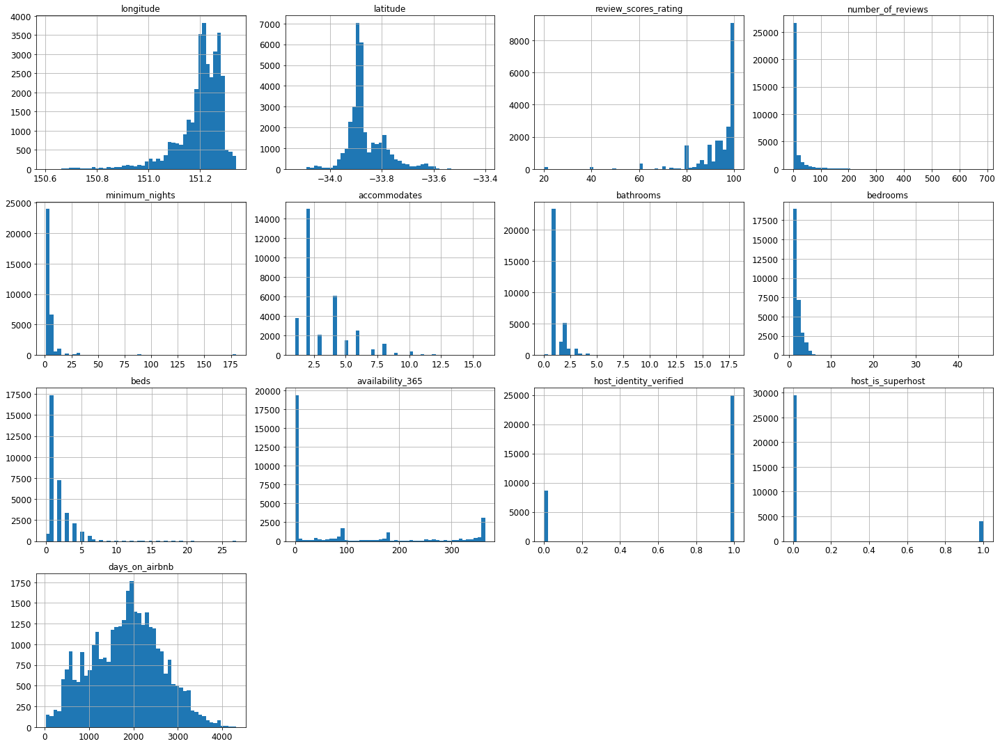

In [39]:
%matplotlib inline
import matplotlib.pyplot as plt

try:
    df.iloc[:,:].hist(bins=50, figsize=(20,15))
    save_fig("attribute_histogram_plots")
    plt.show()
except AttributeError:
    pass

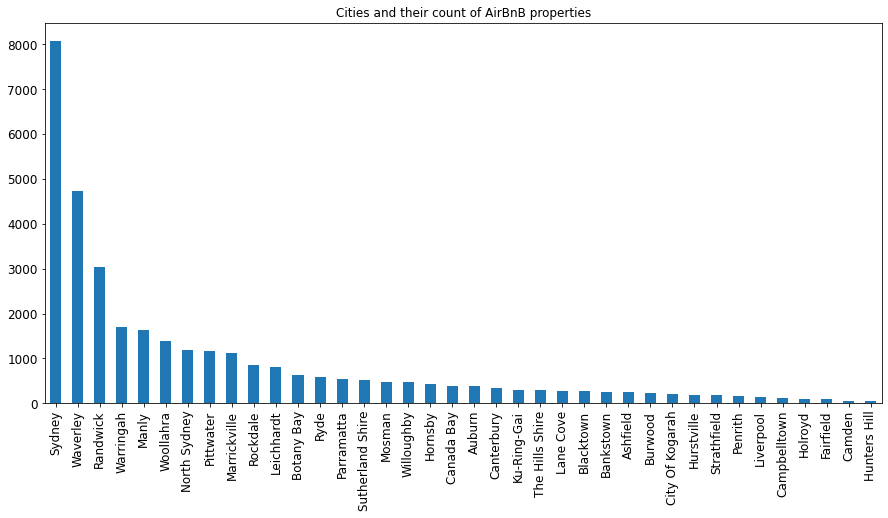

In [40]:
df["city"].value_counts().plot(kind='bar', figsize=(15,7))
plt.title('Cities and their count of AirBnB properties')
plt.show()

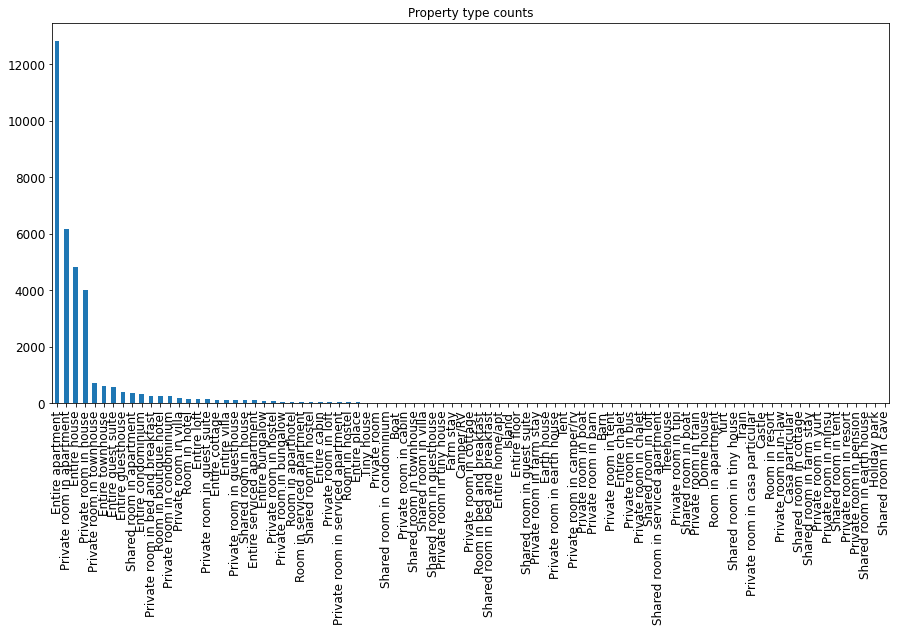

In [41]:
df["property_type"].value_counts().plot(kind='bar',figsize=(15,7))
plt.title('Property type counts')
plt.show()

In [42]:
#Cleaning Price

df['price'] = pd.to_numeric(df['price'].str.replace(',',"").str[1:])
df['price2'] = df.price.copy()

<ipython-input-42-c5a643956269>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['price'] = pd.to_numeric(df['price'].str.replace(',',"").str[1:])
<ipython-input-42-c5a643956269>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['price2'] = df.price.copy()


In [43]:
df.describe()

,price,longitude,latitude,review_scores_rating,number_of_reviews,minimum_nights,accommodates,bathrooms,bedrooms,beds,availability_365,host_identity_verified,host_is_superhost,days_on_airbnb,price2
count,33630.000000,33630.000000,33630.000000,22376.000000,33630.000000,33630.000000,33630.000000,33524.000000,31421.000000,33225.000000,33630.000000,33630.000000,33630.000000,33596.000000,33630.000000
mean,222.013440,151.199954,-33.862335,93.234135,14.348855,5.428219,3.266994,1.358325,1.667738,1.919759,88.814392,0.743503,0.121291,1839.480772,222.013440
std,472.636189,0.089769,0.074736,10.869062,36.384842,14.353332,2.146717,0.739993,1.053097,1.495540,131.055115,0.436706,0.326469,795.101011,472.636189
min,5.000000,150.601960,-34.135590,20.000000,0.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,28.000000,5.000000
25%,74.000000,151.175410,-33.899950,91.000000,0.000000,1.000000,2.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,1234.000000,74.000000
50%,120.000000,151.215005,-33.882560,97.000000,2.000000,2.000000,2.000000,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,1888.000000,120.000000
75%,219.000000,151.260610,-33.827280,100.000000,9.000000,5.000000,4.000000,1.500000,2.000000,2.000000,165.000000,1.000000,0.000000,2392.000000,219.000000
max,28613.000000,151.339810,-33.400300,100.000000,685.000000,180.000000,16.000000,18.000000,46.000000,27.000000,365.000000,1.000000,1.000000,4315.000000,28613.000000


In [44]:
df.price.describe()

count    33630.000000
mean       222.013440
std        472.636189
min          5.000000
25%         74.000000
50%        120.000000
75%        219.000000
max      28613.000000
Name: price, dtype: float64

/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


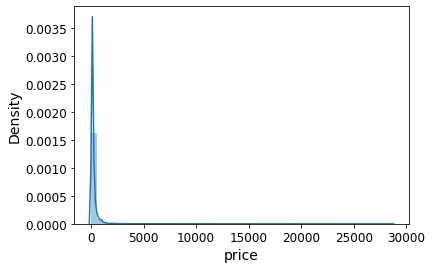

In [45]:
sns.distplot(df.price);

#Right skewed

/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


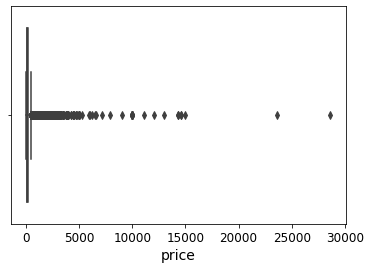

In [46]:
sns.boxplot(df.price);

In [47]:
df.price.skew()

20.744609054103023

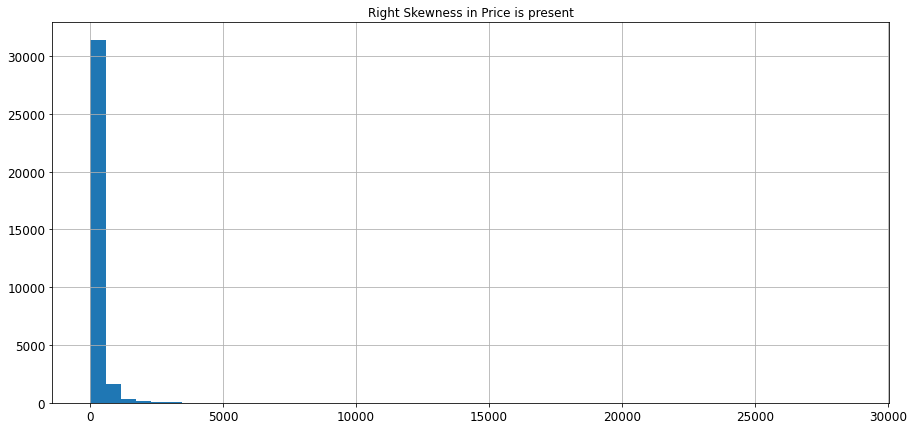

In [48]:
df['price'].hist(bins=50, figsize=(15,7))
plt.title('Right Skewness in Price is present');

In [49]:
#Treat Skewness in Price

#Price: Treat high skewness
#Output Variable
#No missing values
#Winscorize outlier
#Transformation required : log

df = df[df["price"]<df["price"].quantile(0.995)].reset_index(drop=True)

In [50]:
df.skew()

price                     3.837027
longitude                -2.070484
latitude                  1.119327
review_scores_rating     -3.418196
number_of_reviews         5.301661
minimum_nights            8.979721
accommodates              1.669575
bathrooms                 5.924495
bedrooms                  4.192608
beds                      2.345763
availability_365          1.201929
host_identity_verified   -1.111554
host_is_superhost         2.319473
days_on_airbnb           -0.001251
price2                    3.837027
dtype: float64

<AxesSubplot:xlabel='host_is_superhost', ylabel='host_is_superhost'>

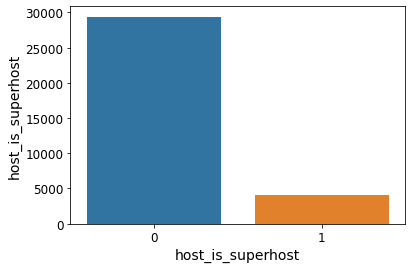

In [51]:
sns.barplot(x = df['host_is_superhost'], y = df['host_is_superhost'].value_counts())

In [52]:
#sns.boxplot(x = df['host_is_superhost'], y=df['price'])

In [53]:
#sns.boxplot(x = df['city'], y=df['price']);

In [54]:
#sns.boxplot(x = df['property_type'], y=df['price']);

In [55]:
#Transformation #'price'
from scipy import stats
for i in ['number_of_reviews','minimum_nights','accommodates',
         ]:
    fitted_data, fitted_lambda = stats.yeojohnson(df[i])  
    df[i] = fitted_data

In [56]:
from sklearn.preprocessing import PowerTransformer
pt = PowerTransformer()  
df['price'] = pt.fit_transform(df[['price']])

In [57]:
df.skew()

price                     0.019116
longitude                -2.070484
latitude                  1.119327
review_scores_rating     -3.418196
number_of_reviews         0.216789
minimum_nights            0.181584
accommodates              0.061514
bathrooms                 5.924495
bedrooms                  4.192608
beds                      2.345763
availability_365          1.201929
host_identity_verified   -1.111554
host_is_superhost         2.319473
days_on_airbnb           -0.001251
price2                    3.837027
dtype: float64

Saving figure After transformation - attribute_histogram_plots


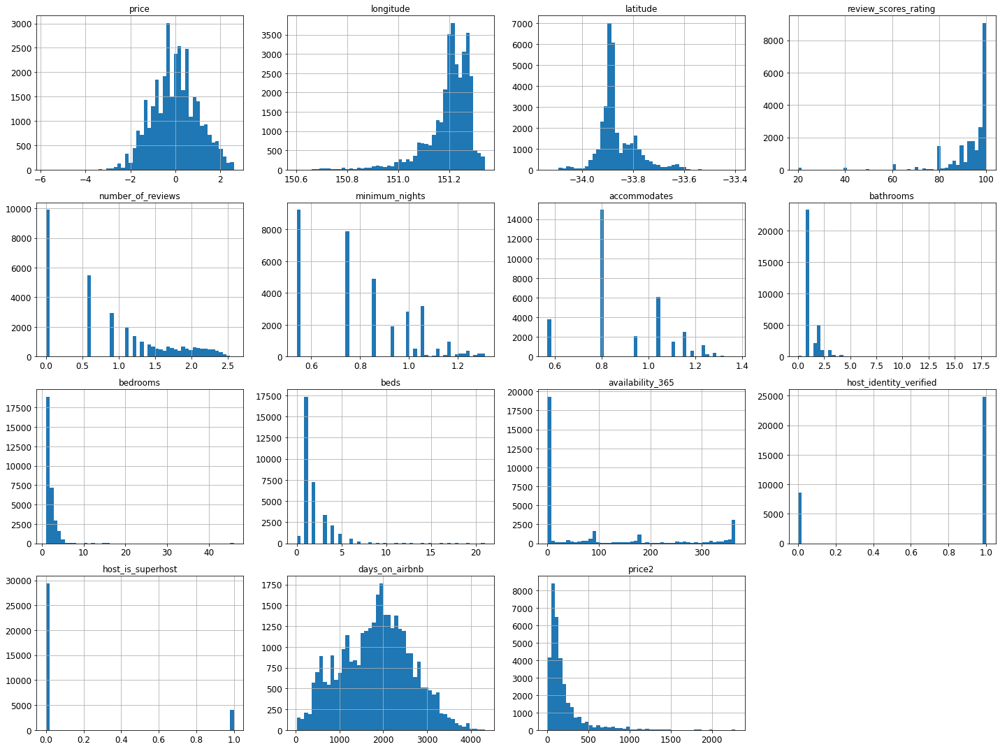

In [58]:
%matplotlib inline
import matplotlib.pyplot as plt

try:
    df.iloc[:,:].hist(bins=50, figsize=(20,15))
    save_fig("After transformation - attribute_histogram_plots")
    plt.show()
except AttributeError:
    pass

In [59]:
df.shape

(33460, 19)

In [60]:
#outliers 
print('Number of price outliers rows: ',data.shape[0]-df.shape[0])

Number of price outliers rows:  170


<AxesSubplot:xlabel='host_is_superhost', ylabel='host_is_superhost'>

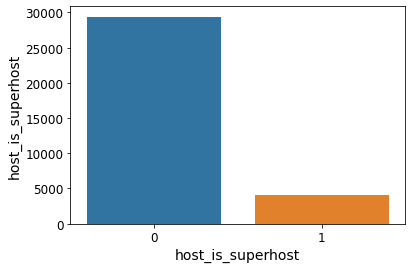

In [61]:
sns.barplot(x = df['host_is_superhost'], y = df['host_is_superhost'].value_counts())

<AxesSubplot:xlabel='host_is_superhost', ylabel='price'>

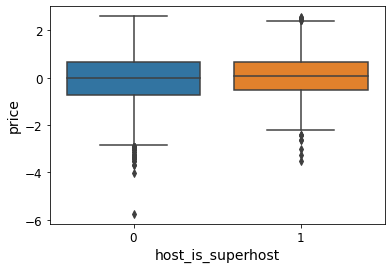

In [62]:
sns.boxplot(x = df['host_is_superhost'], y=df['price'])

In [63]:
df.columns

Index(['price', 'city', 'amenities', 'longitude', 'latitude',
       'review_scores_rating', 'number_of_reviews', 'minimum_nights',
       'accommodates', 'bathrooms', 'bedrooms', 'beds', 'property_type',
       'room_type', 'availability_365', 'host_identity_verified',
       'host_is_superhost', 'days_on_airbnb', 'price2'],
      dtype='object')

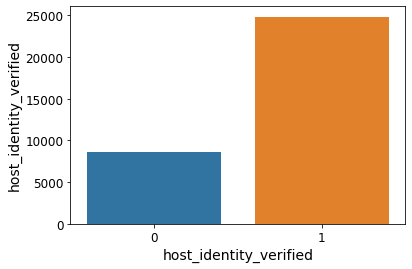

In [64]:
sns.barplot(x = df['host_identity_verified'], y = df['host_identity_verified'].value_counts());

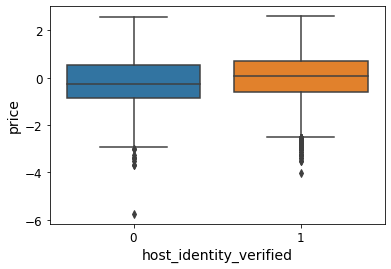

In [65]:
sns.boxplot(x = df['host_identity_verified'], y=df['price']);

In [66]:
#Drop host_identity_verified, host_is_superhost 
#as box plot doesnot significant difference in price

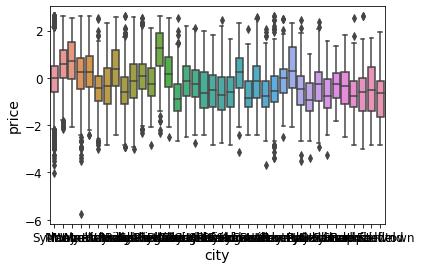

In [67]:
sns.boxplot(x = df['city'], y=df['price']);

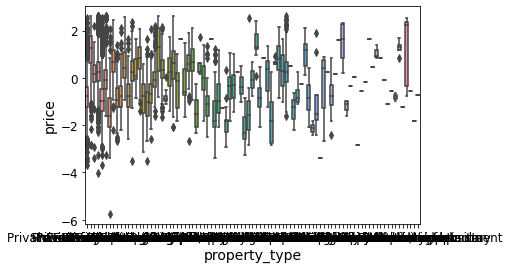

In [68]:
sns.boxplot(x = df['property_type'], y=df['price']  );

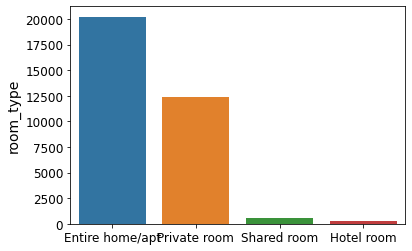

In [69]:
R = df['room_type'].value_counts()
sns.barplot(x = R.index.values, y = df['room_type'].value_counts() )

plt.show()

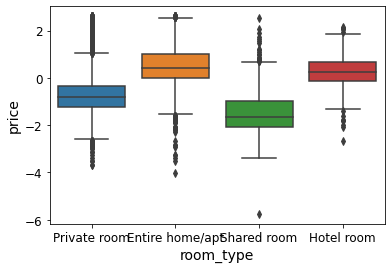

In [70]:
sns.boxplot(x = df['room_type'], y=df['price']);

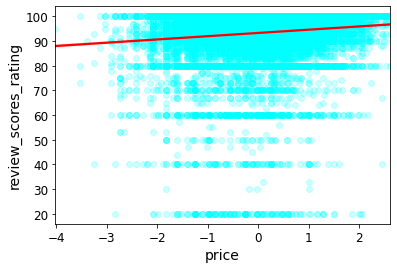

In [71]:
sns.regplot(x = df['price'], y = df['review_scores_rating'], line_kws = {'color':'r'},
           scatter_kws = {'color':'cyan', 'alpha':0.2})
plt.show()

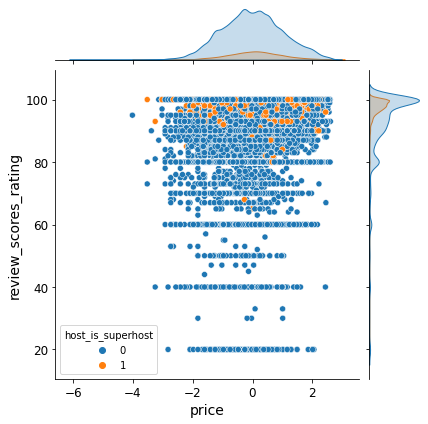

In [72]:
sns.jointplot(x = df['price'], y = df['review_scores_rating'], hue = df['host_is_superhost']
           )
plt.show()

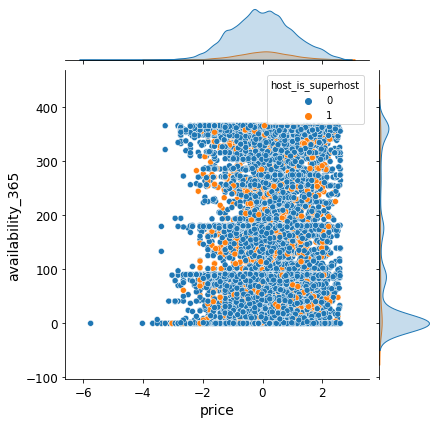

In [73]:
sns.jointplot(x = df['price'], y = df['availability_365'], hue = df['host_is_superhost']
           )
plt.show()

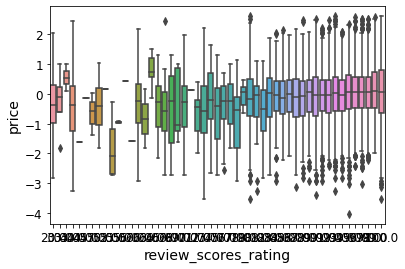

In [74]:
sns.boxplot(x = df['review_scores_rating'], y=df['price']);

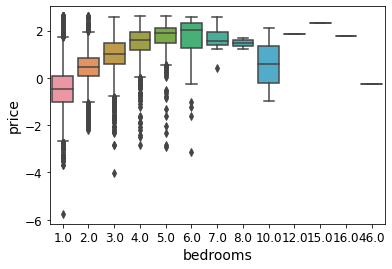

In [75]:
sns.boxplot(x = df['bedrooms'], y=df['price']);

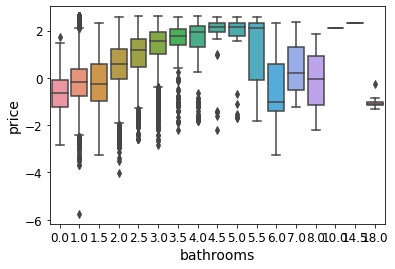

In [76]:
sns.boxplot(x = df['bathrooms'], y=df['price']);

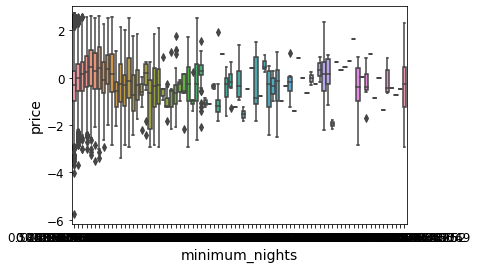

In [77]:
sns.boxplot(x = df['minimum_nights'], y=df['price']);

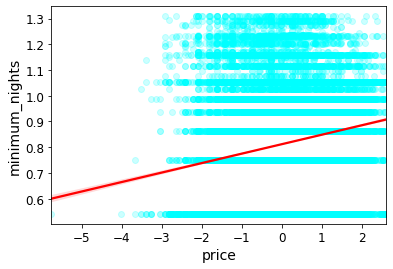

In [78]:
sns.regplot(x = df['price'], y = df['minimum_nights'], line_kws = {'color':'r'},
           scatter_kws = {'color':'cyan', 'alpha':0.2})
plt.show()

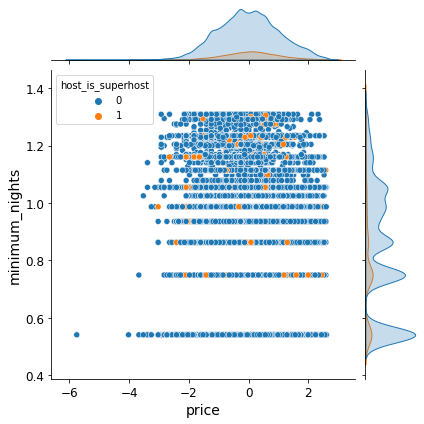

In [79]:
sns.jointplot(x = df['price'], y = df['minimum_nights'], hue = df['host_is_superhost']
           )
plt.show()

In [80]:
#Encoding city
from sklearn import preprocessing
le = preprocessing.LabelEncoder()

for col in ["city"]:
    df[col+"_code"] = le.fit_transform(df[col])

In [81]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33460 entries, 0 to 33459
Data columns (total 20 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   price                   33460 non-null  float64
 1   city                    33460 non-null  object 
 2   amenities               33460 non-null  object 
 3   longitude               33460 non-null  float64
 4   latitude                33460 non-null  float64
 5   review_scores_rating    22336 non-null  float64
 6   number_of_reviews       33460 non-null  float64
 7   minimum_nights          33460 non-null  float64
 8   accommodates            33460 non-null  float64
 9   bathrooms               33354 non-null  float64
 10  bedrooms                31264 non-null  float64
 11  beds                    33065 non-null  float64
 12  property_type           33460 non-null  object 
 13  room_type               33460 non-null  object 
 14  availability_365        33460 non-null

In [82]:
#Treating Missing Values

#review_scores_rating
df.review_scores_rating.isna().sum()

11124

In [83]:
df.review_scores_rating.min(), df.review_scores_rating.max()

(20.0, 100.0)

In [84]:
#Binning can be done
df['review_scores_rating'] = pd.cut(df.review_scores_rating, bins = [0, 25, 50, 75, 95 ,100],
                                    labels = ['1','2','3','4','5'])

In [85]:
df['review_scores_rating'] 

0          4
1          4
2          4
3          5
4          4
        ... 
33455    NaN
33456    NaN
33457    NaN
33458    NaN
33459    NaN
Name: review_scores_rating, Length: 33460, dtype: category
Categories (5, object): ['1' < '2' < '3' < '4' < '5']

In [86]:
df.review_scores_rating.replace({np.NaN:'no reviews'}, inplace = True)
df.review_scores_rating = df.review_scores_rating.astype('category') 
df['property_type'] = df.property_type.astype('category') 
df['room_type'] = df.room_type.astype('category') 
df['city'] = df.city.astype('category') 

In [87]:
df.review_scores_rating.value_counts()

5             12879
no reviews    11124
4              8405
3               748
2               160
1               144
Name: review_scores_rating, dtype: int64

<AxesSubplot:xlabel='review_scores_rating', ylabel='price'>

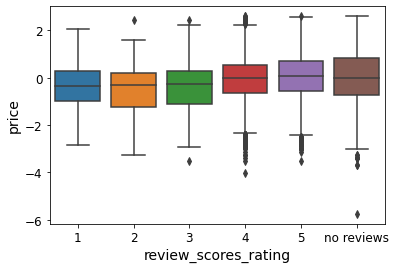

In [88]:
sns.boxplot(x = df.review_scores_rating, y = df.price)

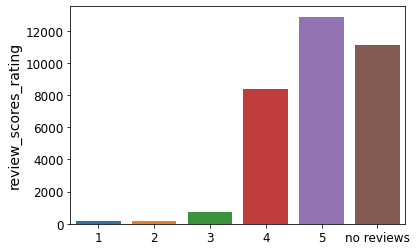

In [89]:
sns.barplot(x = df.review_scores_rating.value_counts().index.values,
            y = df.review_scores_rating.value_counts())
plt.show()

In [90]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33460 entries, 0 to 33459
Data columns (total 20 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   price                   33460 non-null  float64 
 1   city                    33460 non-null  category
 2   amenities               33460 non-null  object  
 3   longitude               33460 non-null  float64 
 4   latitude                33460 non-null  float64 
 5   review_scores_rating    33460 non-null  category
 6   number_of_reviews       33460 non-null  float64 
 7   minimum_nights          33460 non-null  float64 
 8   accommodates            33460 non-null  float64 
 9   bathrooms               33354 non-null  float64 
 10  bedrooms                31264 non-null  float64 
 11  beds                    33065 non-null  float64 
 12  property_type           33460 non-null  category
 13  room_type               33460 non-null  category
 14  availability_365      

In [91]:
#df.drop(columns = ['amenities','host_identity_verified','host_is_superhost' ], inplace = True )

In [92]:
df.corr()

,price,longitude,latitude,number_of_reviews,minimum_nights,accommodates,bathrooms,bedrooms,beds,availability_365,host_identity_verified,host_is_superhost,days_on_airbnb,price2,city_code
price,1.000000,0.287471,0.195947,-0.010454,0.174511,0.679944,0.346418,0.614051,0.533727,0.106865,0.094383,0.031302,0.142643,0.762892,0.155013
longitude,0.287471,1.000000,0.099824,-0.036349,0.202852,0.118474,0.035750,0.106168,0.064691,-0.127296,0.059751,-0.036034,0.231561,0.220526,0.500482
latitude,0.195947,0.099824,1.000000,0.033380,0.019186,0.163222,0.118130,0.193618,0.175306,0.094262,0.011286,0.063124,0.002619,0.219293,-0.054402
number_of_reviews,-0.010454,-0.036349,0.033380,1.000000,-0.182410,0.108332,-0.058161,-0.025231,0.030111,0.129157,0.207317,0.400626,0.094976,-0.093310,-0.009077
minimum_nights,0.174511,0.202852,0.019186,-0.182410,1.000000,0.150913,0.140792,0.210619,0.139379,-0.077340,-0.029772,-0.100050,0.188015,0.156803,0.121793
accommodates,0.679944,0.118474,0.163222,0.108332,0.150913,1.000000,0.421141,0.729513,0.724302,0.015066,0.105016,0.037056,0.067285,0.521006,0.031026
bathrooms,0.346418,0.035750,0.118130,-0.058161,0.140792,0.421141,1.000000,0.569755,0.510043,0.041845,0.022075,-0.016325,0.016378,0.464157,-0.024296
bedrooms,0.614051,0.106168,0.193618,-0.025231,0.210619,0.729513,0.569755,1.000000,0.784093,0.014583,0.036345,-0.020343,0.070871,0.625558,0.005609
beds,0.533727,0.064691,0.175306,0.030111,0.139379,0.724302,0.510043,0.784093,1.000000,0.032546,0.047613,0.009798,0.028289,0.532816,-0.006388
availability_365,0.106865,-0.127296,0.094262,0.129157,-0.077340,0.015066,0.041845,0.014583,0.032546,1.000000,0.053132,0.139714,-0.103751,0.106981,-0.092197


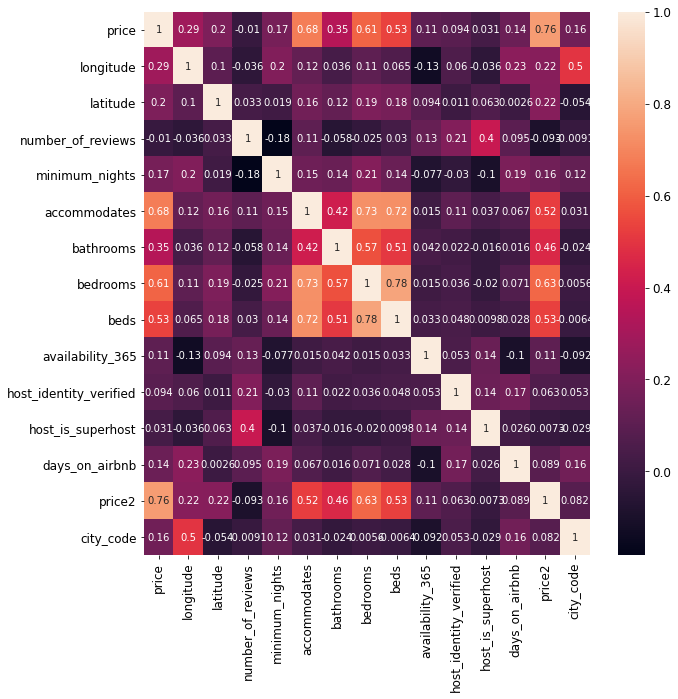

In [93]:
fig, ax = plt.subplots(figsize=(10,10))   
sns.heatmap(df.corr(),annot= True, ax = ax);
plt.show()

#high correlation observed between beds and bedrooms,
#drop beds as it has lower correlation with price

#bedrooms and accomodations

#bathrooms and bedrooms


In [94]:
#multicollinearity between beds, bedrooms, bathrooms, accomodations

In [95]:
#Feature engineering
df['beds_per_bedrooms'] = df['beds']/df['bedrooms']
df['bedrooms_per_accommodates'] = df['bedrooms']/df['accommodates']
df['beds_per_accommodates'] = df['beds']/df['accommodates']
df['bathrooms_per_accommodates'] = df['bathrooms']/df['accommodates']

In [96]:
df.drop(columns = ['amenities','bathrooms','bedrooms','beds' ], inplace = True )
#'host_identity_verified','host_is_superhost'

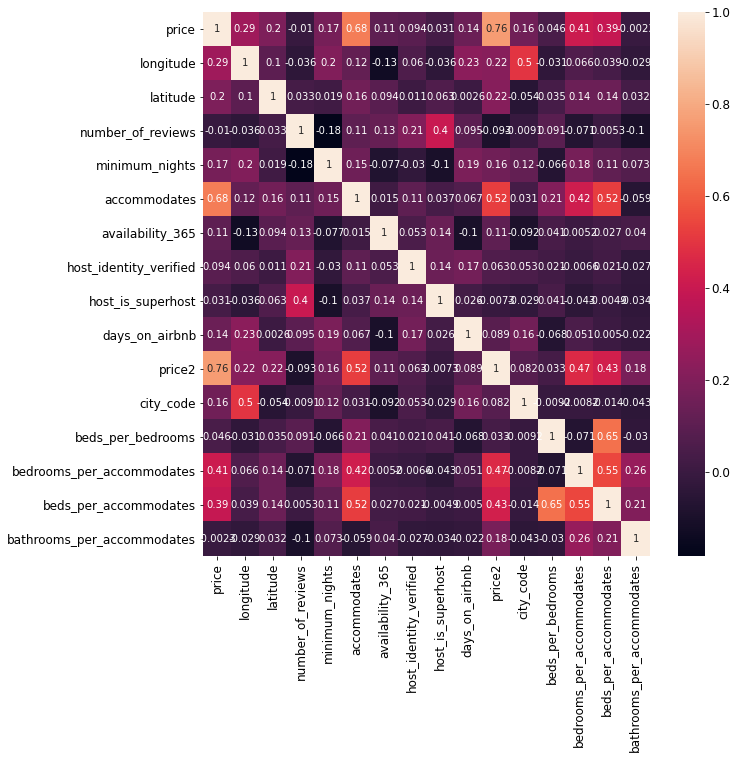

In [97]:
fig, ax = plt.subplots(figsize=(10,10))   
sns.heatmap(df.corr(),annot= True, ax = ax);
plt.show()

In [98]:
df.head()

,price,city,longitude,latitude,review_scores_rating,number_of_reviews,minimum_nights,accommodates,property_type,room_type,availability_365,host_identity_verified,host_is_superhost,days_on_airbnb,price2,city_code,beds_per_bedrooms,bedrooms_per_accommodates,beds_per_accommodates,bathrooms_per_accommodates
0,-0.857560,Sydney,151.22688,-33.86934,4,2.424401,0.748993,0.568106,Private room in apartment,Private room,364,0,0,4183.0,65.0,32,0.0,1.760235,0.000000,1.760235
1,1.435653,Manly,151.26172,-33.80093,4,0.913807,0.986668,1.153217,Entire house,Entire home/apt,59,1,1,4125.0,470.0,20,1.0,2.601419,2.601419,2.601419
2,-0.579212,Sydney,151.21680,-33.87964,4,2.513886,0.748993,0.806747,Private room in apartment,Private room,360,1,0,4112.0,79.0,32,1.0,1.239546,1.239546,1.239546
3,0.075179,Sydney,151.21439,-33.87888,5,2.246204,0.862740,0.806747,Entire loft,Entire home/apt,0,1,1,3972.0,130.0,32,1.0,1.239546,1.239546,1.239546
4,0.165947,Mosman,151.23652,-33.81927,4,2.480536,0.748993,1.036054,Entire house,Entire home/apt,315,1,0,3774.0,140.0,22,1.0,0.965201,0.965201,0.965201


In [99]:
df.isna().sum()

price                            0
city                             0
longitude                        0
latitude                         0
review_scores_rating             0
number_of_reviews                0
minimum_nights                   0
accommodates                     0
property_type                    0
room_type                        0
availability_365                 0
host_identity_verified           0
host_is_superhost                0
days_on_airbnb                  34
price2                           0
city_code                        0
beds_per_bedrooms             2549
bedrooms_per_accommodates     2196
beds_per_accommodates          395
bathrooms_per_accommodates     106
dtype: int64

In [100]:
df.shape

(33460, 20)

In [101]:
df.city.nunique()

38

In [102]:
df.city.value_counts()

Sydney              8041
Waverley            4711
Randwick            3037
Warringah           1700
Manly               1617
Woollahra           1357
North Sydney        1187
Pittwater           1135
Marrickville        1110
Rockdale             855
Leichhardt           815
Botany Bay           627
Ryde                 594
Parramatta           536
Sutherland Shire     510
Willoughby           475
Mosman               473
Hornsby              425
Canada Bay           382
Auburn               376
Canterbury           337
Ku-Ring-Gai          306
The Hills Shire      290
Lane Cove            284
Blacktown            276
Bankstown            259
Ashfield             254
Burwood              230
City Of Kogarah      214
Hurstville           180
Strathfield          177
Penrith              165
Liverpool            138
Campbelltown         104
Holroyd               94
Fairfield             86
Camden                52
Hunters Hill          51
Name: city, dtype: int64

In [103]:
#Consider Top 20 cities
#list_of_20 = list(df["city"].value_counts().head(10).index)
#df = df[df["city"].isin(list_of_20)] #.reset_index(drop=True)

In [104]:
df.shape

(33460, 20)

In [105]:
df.property_type.value_counts()

Entire apartment                   12794
Private room in apartment           6165
Entire house                        4758
Private room in house               4020
Private room in townhouse            718
                                   ...  
Private room in in-law                 1
Holiday park                           1
Treehouse                              1
Private room in casa particular        1
Yurt                                   1
Name: property_type, Length: 89, dtype: int64

In [106]:
#Property type with lower occurences are removed
item_counts = df.groupby(['property_type']).size()
rare_items = list(item_counts.loc[item_counts <= 10].index.values)

In [107]:
df = df[~df["property_type"].isin(rare_items)] #reset_index(drop=True)

In [108]:
df.shape

(33359, 20)

In [109]:
df = pd.get_dummies(df,drop_first=True)

In [110]:
df

,price,longitude,latitude,number_of_reviews,minimum_nights,accommodates,availability_365,host_identity_verified,host_is_superhost,days_on_airbnb,price2,city_code,beds_per_bedrooms,bedrooms_per_accommodates,beds_per_accommodates,bathrooms_per_accommodates,city_Auburn,city_Bankstown,city_Blacktown,city_Botany Bay,city_Burwood,city_Camden,city_Campbelltown,city_Canada Bay,city_Canterbury,city_City Of Kogarah,city_Fairfield,city_Holroyd,city_Hornsby,city_Hunters Hill,city_Hurstville,city_Ku-Ring-Gai,city_Lane Cove,city_Leichhardt,city_Liverpool,city_Manly,city_Marrickville,city_Mosman,city_North Sydney,city_Parramatta,city_Penrith,city_Pittwater,city_Randwick,city_Rockdale,city_Ryde,city_Strathfield,city_Sutherland Shire,city_Sydney,city_The Hills Shire,city_Warringah,city_Waverley,city_Willoughby,city_Woollahra,review_scores_rating_2,review_scores_rating_3,review_scores_rating_4,review_scores_rating_5,review_scores_rating_no reviews,property_type_Boat,property_type_Camper/RV,property_type_Casa particular,property_type_Castle,property_type_Dome house,property_type_Earth house,property_type_Entire apartment,property_type_Entire bungalow,property_type_Entire cabin,property_type_Entire chalet,property_type_Entire condominium,property_type_Entire cottage,property_type_Entire floor,property_type_Entire guest suite,property_type_Entire guesthouse,property_type_Entire home/apt,property_type_Entire house,property_type_Entire loft,property_type_Entire place,property_type_Entire serviced apartment,property_type_Entire townhouse,property_type_Entire villa,property_type_Farm stay,property_type_Holiday park,property_type_Island,property_type_Private room,property_type_Private room in apartment,property_type_Private room in barn,property_type_Private room in bed and breakfast,property_type_Private room in boat,property_type_Private room in bungalow,property_type_Private room in bus,property_type_Private room in cabin,property_type_Private room in camper/rv,property_type_Private room in casa particular,property_type_Private room in chalet,property_type_Private room in condominium,property_type_Private room in cottage,property_type_Private room in earth house,property_type_Private room in farm stay,property_type_Private room in guest suite,property_type_Private room in guesthouse,property_type_Private room in hostel,property_type_Private room in house,property_type_Private room in in-law,property_type_Private room in loft,property_type_Private room in minsu,property_type_Private room in pension,property_type_Private room in resort,property_type_Private room in serviced apartment,property_type_Private room in tent,property_type_Private room in tiny house,property_type_Private room in tipi,property_type_Private room in townhouse,property_type_Private room in train,property_type_Private room in villa,property_type_Private room in yurt,property_type_Room in aparthotel,property_type_Room in apartment,property_type_Room in bed and breakfast,property_type_Room in boutique hotel,property_type_Room in hostel,property_type_Room in hotel,property_type_Room in resort,property_type_Room in serviced apartment,property_type_Shared room in apartment,property_type_Shared room in bed and breakfast,property_type_Shared room in boat,property_type_Shared room in cave,property_type_Shared room in condominium,property_type_Shared room in cottage,property_type_Shared room in earth house,property_type_Shared room in farm stay,property_type_Shared room in guest suite,property_type_Shared room in guesthouse,property_type_Shared room in hostel,property_type_Shared room in house,property_type_Shared room in loft,property_type_Shared room in serviced apartment,property_type_Shared room in tent,property_type_Shared room in tiny house,property_type_Shared room in townhouse,property_type_Shared room in villa,property_type_Tent,property_type_Tiny house,property_type_Train,property_type_Treehouse,property_type_Yurt,room_type_Hotel room,room_type_Private room,room_type_Shared room


In [111]:
df.shape

(33359, 149)

In [112]:
df = pd.merge(df,Amenities_pd,left_on= df.index,right_on=Amenities_pd.index)
df.drop(columns = ['key_0','price'],inplace = True)

In [113]:
df['price'] = df.price2
df.drop(columns = ['price2'], inplace = True)

In [114]:
#df.dropna(inplace = True)

In [115]:
df.isna().sum().sum()

5239

In [116]:
df = df.reindex()

In [117]:
from sklearn.model_selection import StratifiedShuffleSplit

#stratify according to city


#df = pd.concat([df,Amenities_pd],axis = 1)
#print(df.shape)

split = StratifiedShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
for train_index, test_index in split.split(df, df["city_code"]):
    del df["city_code"]
    strat_train_set = df.loc[train_index]
    strat_test_set = df.loc[test_index]
    
#strat_train_set.info()

In [118]:
#strat_test_set.groupby("city").agg({"price":['mean','count']})

In [119]:
#strat_train_set.groupby("city").agg({"price":['mean','count']})

In [120]:
#treat missing values
X = strat_train_set.copy()
y = X.pop('price')
cols = X.columns

yy = y.copy()

#Transform price
pt1 = PowerTransformer()
y = pt1.fit_transform((np.array(y)).reshape(-1, 1))

In [121]:
from sklearn.impute import KNNImputer
s1 = KNNImputer(n_neighbors=10)
X['days_on_airbnb'] =  s1.fit_transform(X[['days_on_airbnb']]) 

s3 = KNNImputer(n_neighbors=10)
X['beds_per_bedrooms'] = s3.fit_transform(X[['beds_per_bedrooms']])      

s4 = KNNImputer(n_neighbors=10)
X['bedrooms_per_accommodates'] = s4.fit_transform(X[['bedrooms_per_accommodates']]) 

s5 = KNNImputer(n_neighbors=10)
X['beds_per_accommodates'] =   s5.fit_transform(X[['beds_per_accommodates']]) 

s6 = KNNImputer(n_neighbors=10)
X['bathrooms_per_accommodates'] = s6.fit_transform(X[['bathrooms_per_accommodates']]) 

In [122]:
#standardize availability_365, days_on_airbnb
#Standard Scale
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X = sc.fit_transform(X)

In [123]:
#test set preparation
XT = strat_test_set.copy()
yT = XT.pop('price')

#XT = si.transform(XT)

XT['days_on_airbnb'] =  s1.transform(XT[['days_on_airbnb']]) 

XT['beds_per_bedrooms'] = s3.transform(XT[['beds_per_bedrooms']])      

XT['bedrooms_per_accommodates'] = s4.transform(XT[['bedrooms_per_accommodates']]) 

XT['beds_per_accommodates'] =   s5.transform(XT[['beds_per_accommodates']]) 

XT['bathrooms_per_accommodates'] = s6.transform(XT[['bathrooms_per_accommodates']]) 

XT = sc.transform(XT)

In [124]:
X.shape,y.shape

((26687, 1071), (26687, 1))

In [125]:
XT.shape, yT.shape

((6672, 1071), (6672,))

In [126]:
#stratification ratio
X.shape[0]/yT.shape[0]

3.999850119904077

In [127]:
import xgboost as xgb
model1 = xgb.XGBRegressor()
model1.fit(X,y)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.300000012, max_delta_step=0, max_depth=6,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=100, n_jobs=4, num_parallel_tree=1, random_state=0,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [128]:
model1.feature_importances_

array([0.00449739, 0.00334737, 0.00389464, ..., 0.        , 0.        ,
       0.        ], dtype=float32)

In [129]:
len(model1.feature_importances_)

1071

In [130]:
pd.DataFrame(data = {'columns':cols,'Importances':model1.feature_importances_}).sort_values('Importances',ascending  = False)[:35]

,columns,Importances
4,accommodates,0.159376
144,room_type_Private room,0.135854
145,room_type_Shared room,0.115966
83,property_type_Private room in bed and breakfast,0.055286
10,bedrooms_per_accommodates,0.050372
115,property_type_Room in boutique hotel,0.021621
117,property_type_Room in hotel,0.018988
71,property_type_Entire house,0.014435
130,property_type_Shared room in hostel,0.013019
37,city_Penrith,0.009790


<Figure size 2160x2160 with 0 Axes>

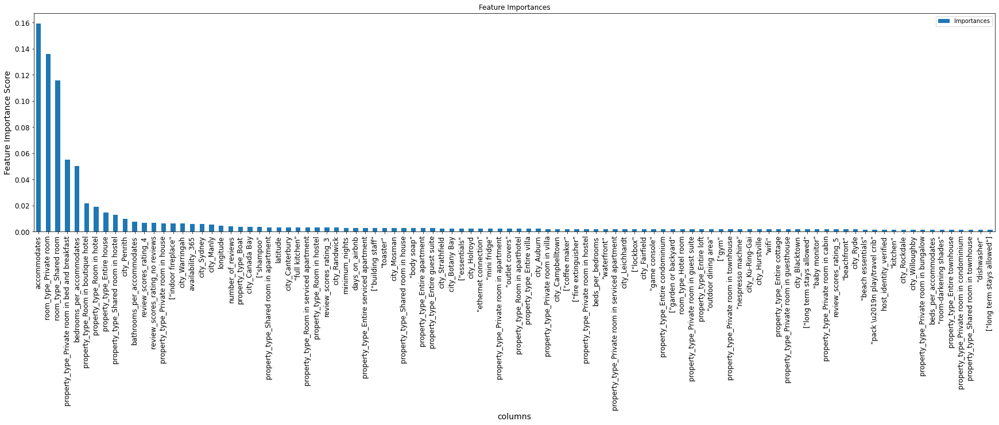

In [131]:
f = plt.figure(figsize = (30,30))
feat_imp = pd.DataFrame(data = {'columns':cols,'Importances':model1.feature_importances_}).sort_values('Importances',ascending  = False)[:100]
feat_imp.set_index('columns').plot(kind='bar', title='Feature Importances',figsize=(30,7))
plt.ylabel('Feature Importance Score');

In [132]:
#print('Train Score:',round(model1.score(X,y),2)*100,'%')

In [133]:
from sklearn.metrics import r2_score,mean_squared_error,mean_absolute_error
y_pre = model1.predict(X)
print(y_pre.shape)
y_pred = pt1.inverse_transform(y_pre.reshape(-1,1))

print(y_pre.shape)
print('Train R2:', r2_score(yy,y_pred))
print('Train MAE:', mean_absolute_error(yy,y_pred))
print('Train RMSE:', mean_squared_error(yy,y_pred,squared=False))

a=[]
b=[]
c=[]
d=[]
e=[]
f=[]
a.append(r2_score(yy,y_pred))
b.append(mean_absolute_error(yy,y_pred))
c.append(mean_squared_error(yy,y_pred,squared=False))

(26687,)
(26687,)
Train R2: 0.7298285890041034
Train MAE: 56.223078645780575
Train RMSE: 128.17897282549148


In [134]:
from sklearn.metrics import r2_score,mean_squared_error,mean_absolute_error
y_pre = model1.predict(XT)
print(y_pre.shape)
y_pred = pt1.inverse_transform(y_pre.reshape(-1,1))

print(y_pre.shape)
print('Test R2:', r2_score(yT,y_pred))
print('Test MAE:', mean_absolute_error(yT,y_pred))
print('Test RMSE:', mean_squared_error(yT,y_pred,squared=False))

d.append(r2_score(yT,y_pred))
e.append(mean_absolute_error(yT,y_pred))
f.append(mean_squared_error(yT,y_pred,squared=False))

(6672,)
(6672,)
Test R2: 0.5741310421289147
Test MAE: 69.67811380587608
Test RMSE: 159.49218688509194


import xgboost as xgb
model1 = xgb.XGBRegressor()
model1.fit(X,y)

print('Train Score:',round(model1.score(X,y),2)*100,'%')
print('Test Score:',round(model1.score(XT,yT),2)*100,'%')

In [135]:
from sklearn.ensemble import RandomForestRegressor
model2 = RandomForestRegressor()
model2.fit(X,y)

#print('Train Score:',round(model2.score(X,y),2)*100,'%')
#print('Test Score:',round(model2.score(XT,yT),2)*100,'%')



from sklearn.metrics import r2_score,mean_squared_error,mean_absolute_error
y_pre = model2.predict(X)
print(y_pre.shape)
y_pred = pt1.inverse_transform(y_pre.reshape(-1,1))

print(y_pre.shape)
print('Train R2:', r2_score(yy,y_pred))
print('Train MAE:', mean_absolute_error(yy,y_pred))
print('Train RMSE:', mean_squared_error(yy,y_pred,squared=False))

a.append(r2_score(yy,y_pred))
b.append(mean_absolute_error(yy,y_pred))
c.append(mean_squared_error(yy,y_pred,squared=False))

from sklearn.metrics import r2_score,mean_squared_error,mean_absolute_error
y_pre = model2.predict(XT)
print(y_pre.shape)
y_pred = pt1.inverse_transform(y_pre.reshape(-1,1))

print(y_pre.shape)
print('Test R2:', r2_score(yT,y_pred))
print('Test MAE:', mean_absolute_error(yT,y_pred))
print('Test RMSE:', mean_squared_error(yT,y_pred,squared=False))


d.append(r2_score(yT,y_pred))
e.append(mean_absolute_error(yT,y_pred))
f.append(mean_squared_error(yT,y_pred,squared=False))

<ipython-input-135-28b73bde45bb>:3: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model2.fit(X,y)


(26687,)
(26687,)
Train R2: 0.889806629763518
Train MAE: 30.009143082319806
Train RMSE: 81.86058135165483
(6672,)
(6672,)
Test R2: 0.5820742118984183
Test MAE: 69.74083965844613
Test RMSE: 157.9977875353959


In [136]:
from sklearn.ensemble import GradientBoostingRegressor
model3 = GradientBoostingRegressor()
model3.fit(X,y)

#print('Train Score:',round(model3.score(X,y),2)*100,'%')
#print('Test Score:',round(model3.score(XT,yT),2)*100,'%')


from sklearn.metrics import r2_score,mean_squared_error,mean_absolute_error
y_pre = model3.predict(X)
print(y_pre.shape)
y_pred = pt1.inverse_transform(y_pre.reshape(-1,1))

print(y_pre.shape)
print('Train R2:', r2_score(yy,y_pred))
print('Train MAE:', mean_absolute_error(yy,y_pred))
print('Train RMSE:', mean_squared_error(yy,y_pred,squared=False))

a.append(r2_score(yy,y_pred))
b.append(mean_absolute_error(yy,y_pred))
c.append(mean_squared_error(yy,y_pred,squared=False))


from sklearn.metrics import r2_score,mean_squared_error,mean_absolute_error
y_pre = model3.predict(XT)
print(y_pre.shape)
y_pred = pt1.inverse_transform(y_pre.reshape(-1,1))

print(y_pre.shape)
print('Test R2:', r2_score(yT,y_pred))
print('Test MAE:', mean_absolute_error(yT,y_pred))
print('Test RMSE:', mean_squared_error(yT,y_pred,squared=False))

d.append(r2_score(yT,y_pred))
e.append(mean_absolute_error(yT,y_pred))
f.append(mean_squared_error(yT,y_pred,squared=False))

/opt/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)


(26687,)
(26687,)
Train R2: 0.5813712248553169
Train MAE: 70.26161757126071
Train RMSE: 159.55544517615525
(6672,)
(6672,)
Test R2: 0.5495578445871299
Test MAE: 71.24311799471418
Test RMSE: 164.02911225048942


In [139]:
compare_metrics = pd.DataFrame(data = {'Models':['XgBoost','RFR','Gradient Boosting'],'Train R2':a,
                     'Train MAE':b,'Train RMSE':c,
                     'Test R2':d,'Test MAE':e,
                     'Test RMSE':f})
compare_metrics

,Models,Train R2,Train MAE,Train RMSE,Test R2,Test MAE,Test RMSE
0,XgBoost,0.729829,56.223079,128.178973,0.574131,69.678114,159.492187
1,RFR,0.889807,30.009143,81.860581,0.582074,69.740840,157.997788
2,Gradient Boosting,0.581371,70.261618,159.555445,0.549558,71.243118,164.029112


In [140]:
from sklearn.neighbors import KNeighborsRegressor
model5 = KNeighborsRegressor(n_neighbors = 10)
model5.fit(X,y)

#print('Train Score:',round(model3.score(X,y),2)*100,'%')
#print('Test Score:',round(model3.score(XT,yT),2)*100,'%')


from sklearn.metrics import r2_score,mean_squared_error,mean_absolute_error
y_pre = model5.predict(X)
print(y_pre.shape)
y_pred = pt1.inverse_transform(y_pre.reshape(-1,1))

print(y_pre.shape)
print('Train R2:', r2_score(yy,y_pred))
print('Train MAE:', mean_absolute_error(yy,y_pred))
print('Train RMSE:', mean_squared_error(yy,y_pred,squared=False))

a.append(r2_score(yy,y_pred))
b.append(mean_absolute_error(yy,y_pred))
c.append(mean_squared_error(yy,y_pred,squared=False))


from sklearn.metrics import r2_score,mean_squared_error,mean_absolute_error
y_pre = model5.predict(XT)
print(y_pre.shape)
y_pred = pt1.inverse_transform(y_pre.reshape(-1,1))

print(y_pre.shape)
print('Test R2:', r2_score(yT,y_pred))
print('Test MAE:', mean_absolute_error(yT,y_pred))
print('Test RMSE:', mean_squared_error(yT,y_pred,squared=False))

d.append(r2_score(yT,y_pred))
e.append(mean_absolute_error(yT,y_pred))
f.append(mean_squared_error(yT,y_pred,squared=False))

(26687, 1)
(26687, 1)
Train R2: 0.3593435727707738
Train MAE: 89.65156584998039
Train RMSE: 197.38297263379326
(6672, 1)
(6672, 1)
Test R2: 0.278921356585498
Test MAE: 95.99071153641232
Test RMSE: 207.53566309171958


from bayes_opt import BayesianOptimization
from sklearn.ensemble import GradientBoostingRegressor

model3 = GradientBoostingRegressor()
model3.fit(X,y)

print('Train Score:',round(model3.score(X,y),2)*100,'%')
print('Test Score:',round(model3.score(XT,yT),2)*100,'%')


from sklearn.model_selection import GridSearchCV

param_test = {'n_estimators':range(20,101,10)}
gsearch1 = GridSearchCV(estimator = GradientBoostingRegressor(learning_rate=0.1, 
                                                              min_samples_split=500,
                                                              min_samples_leaf=50,
                                                              max_depth=8,
                                                              max_features='sqrt',
                                                              subsample=0.8,random_state=10), 
param_grid = param_test,n_jobs=4,iid=False, cv=5)
gsearch1.fit(X,y)
gsearch1.best_score_, gsearch1.best_params_, gsearch1.best_estimator_

param_test2 = {'max_depth':range(5,16,2), 'min_samples_split':range(200,1001,200)}
gsearch2 = GridSearchCV(estimator = GradientBoostingRegressor(learning_rate=0.1, 
                                                               n_estimators=100, 
                                                               max_features='sqrt', 
                                                              subsample=0.8, 
                                                              random_state=10), 
param_grid = param_test2 ,n_jobs=4,iid=False, cv=5)
gsearch2.fit(X,y)
gsearch2.best_score_, gsearch2.best_params_, gsearch2.best_estimator_

param_test3 = {'min_samples_leaf':range(2,41,10)}
gsearch3 = GridSearchCV(estimator = GradientBoostingRegressor(learning_rate=0.1, 
                                                               n_estimators=100,
                                                               max_depth=15,
                                                               max_features='sqrt', 
                                                               subsample=0.8, 
                                                               random_state=10,
                                                               min_samples_split = 400), 
param_grid = param_test3,n_jobs=4,iid=False, cv=5)
gsearch3.fit(X,y)
#gsearch3.grid_scores_, gsearch3.best_params_, gsearch3.best_score_
gsearch3.best_score_, gsearch3.best_params_, gsearch3.best_estimator_

param_test4 = {'max_features':range(7,1069,2)}
gsearch4 = GridSearchCV(estimator = GradientBoostingRegressor(learning_rate=0.1, 
                                                               n_estimators=100,
                                                               max_depth=9, 
                                                               min_samples_split=1200, 
                                                               min_samples_leaf=2, 
                                                               subsample=0.8, 
                                                               random_state=10),
param_grid = param_test4, n_jobs=4,iid=False, cv=5)
gsearch4.fit(X,y)
#gsearch4.grid_scores_, gsearch4.best_params_, gsearch4.best_score_
gsearch4.best_score_, gsearch4.best_params_, gsearch4.best_estimator_